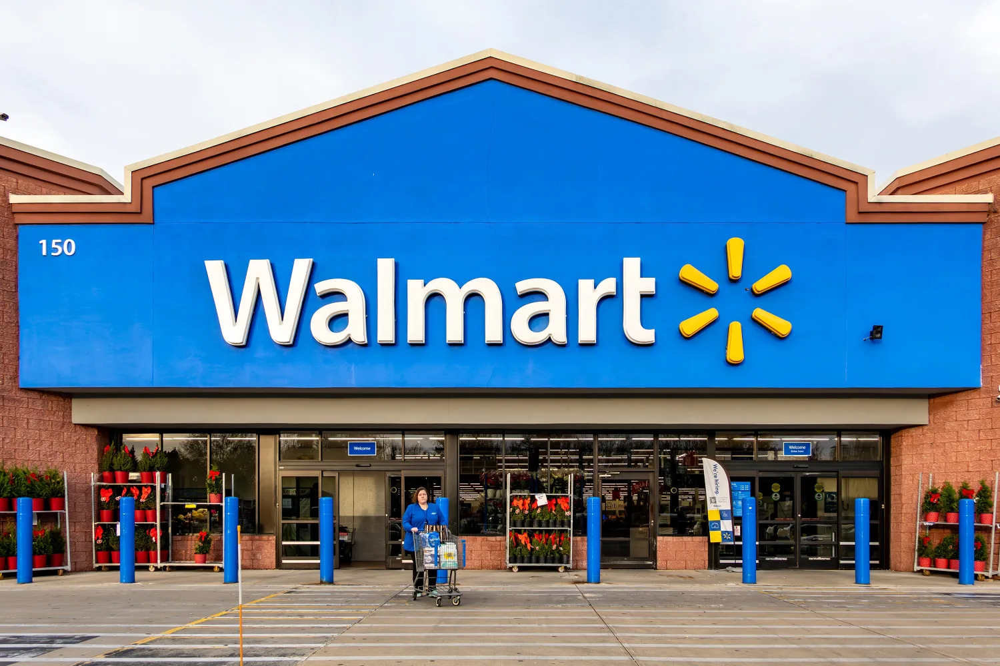

# **Walmart Black Friday Purchases**
The project aims to analyze the customer purchase behavior (specifically, purchase amount) against the customer’s gender and the various other factors to help the business make better decisions. They want to understand if the spending habits differ between male and female customers: Do women spend more on Black Friday than men?


# **Bottom Line Upfront (BLUF):**
Through the use of confidence intervals (CI) and bootstrap methods, we identified key trends in spending patterns.

- Males spend significantly more than females, with average male purchases around \$925,408, compared to \$712,217 for females.
- Single men tend to spend more than married men, suggesting that marital status influences spending behavior, particularly for men.
- Customers aged 25-40 represent the largest proportion of high spenders (over 80%).
- City B drives the most overall sales volume, but City C generates higher average purchases per customer.
- Product categories 6 and 15 are the most expensive, while categories 1, 5, 8, and 11 have the highest purchase frequency.

**Recommendations:**


- Target Male Shoppers: Focus on high-value product promotions for males, as they spend significantly more than females.
- Single Men Focus: Single men spend more than married men, so consider tailored offers for this group.
- Age-Based Strategy: Promote premium products to older age groups (51+), who tend to make higher purchases.
- City-Specific Offers: Target City C with luxury items due to higher average spending, and use discounts to increase transaction sizes in City B.
- Product Categories: Prioritize promotions for high-value categories (6 and 15) and boost sales in frequent purchase categories (1, 5, 8, and 11) with bundled deals.

# Library

In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(color_codes = True)
import scipy.stats as stats
from scipy.stats import norm
import warnings
warnings.filterwarnings("ignore")

# EDA

## Data Overview

In [63]:
#load data
df = pd.read_csv('walmart_data.csv')
df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,7969


In [64]:
df.tail()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
550063,1006033,P00372445,M,51-55,13,B,1,1,20,368
550064,1006035,P00375436,F,26-35,1,C,3,0,20,371
550065,1006036,P00375436,F,26-35,15,B,4+,1,20,137
550066,1006038,P00375436,F,55+,1,C,2,0,20,365
550067,1006039,P00371644,F,46-50,0,B,4+,1,20,490


In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   User_ID                     550068 non-null  int64 
 1   Product_ID                  550068 non-null  object
 2   Gender                      550068 non-null  object
 3   Age                         550068 non-null  object
 4   Occupation                  550068 non-null  int64 
 5   City_Category               550068 non-null  object
 6   Stay_In_Current_City_Years  550068 non-null  object
 7   Marital_Status              550068 non-null  int64 
 8   Product_Category            550068 non-null  int64 
 9   Purchase                    550068 non-null  int64 
dtypes: int64(5), object(5)
memory usage: 42.0+ MB


In [66]:
df.shape

(550068, 10)

In [67]:
df.columns

Index(['User_ID', 'Product_ID', 'Gender', 'Age', 'Occupation', 'City_Category',
       'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category',
       'Purchase'],
      dtype='object')

In [68]:
df.dtypes

,0
User_ID,int64
Product_ID,object
Gender,object
Age,object
Occupation,int64
City_Category,object
Stay_In_Current_City_Years,object
Marital_Status,int64
Product_Category,int64
Purchase,int64


## Finding Unique Values and Count Them
We will find out the unique values in each column. This will help us understand how varied the data is.

In [69]:
def print_unique_values(df):
  for column in df.columns:
    unique_values = df[column].unique()
    print(f"\nUnique Values of {column}:", unique_values)

print_unique_values(df)


Unique Values of User_ID: [1000001 1000002 1000003 ... 1004113 1005391 1001529]

Unique Values of Product_ID: ['P00069042' 'P00248942' 'P00087842' ... 'P00370293' 'P00371644'
 'P00370853']

Unique Values of Gender: ['F' 'M']

Unique Values of Age: ['0-17' '55+' '26-35' '46-50' '51-55' '36-45' '18-25']

Unique Values of Occupation: [10 16 15  7 20  9  1 12 17  0  3  4 11  8 19  2 18  5 14 13  6]

Unique Values of City_Category: ['A' 'C' 'B']

Unique Values of Stay_In_Current_City_Years: ['2' '4+' '3' '1' '0']

Unique Values of Marital_Status: [0 1]

Unique Values of Product_Category: [ 3  1 12  8  5  4  2  6 14 11 13 15  7 16 18 10 17  9 20 19]

Unique Values of Purchase: [ 8370 15200  1422 ...   135   123   613]


In [70]:
def print_nunique_values(df):
  for column in df.columns:
    nunique_values = df[column].nunique()
    print(f"\nNumber of Unique Values of {column}:", nunique_values)

print_nunique_values(df)


Number of Unique Values of User_ID: 5891

Number of Unique Values of Product_ID: 3631

Number of Unique Values of Gender: 2

Number of Unique Values of Age: 7

Number of Unique Values of Occupation: 21

Number of Unique Values of City_Category: 3

Number of Unique Values of Stay_In_Current_City_Years: 5

Number of Unique Values of Marital_Status: 2

Number of Unique Values of Product_Category: 20

Number of Unique Values of Purchase: 18105


## Data Cleaning & Preprocessing

In [71]:
# change column value in Stay_In_Current_City_Years since it has "+" symbols involved.
df['Stay_In_Current_City_Years'] = df['Stay_In_Current_City_Years'].str.replace('+', '')

In [72]:
# check again
df['Stay_In_Current_City_Years'].unique()

array(['2', '4', '3', '1', '0'], dtype=object)

In [73]:
# convert to numeric value
df['Stay_In_Current_City_Years'] = pd.to_numeric(df['Stay_In_Current_City_Years'])

## Statistical Summary

In [74]:
# select numerical columns to see statistics
df.describe(include='all')

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
count,5.500680e+05,550068,550068,550068,550068.000000,550068,550068.000000,550068.000000,550068.000000,550068.000000
unique,NaN,3631,2,7,NaN,3,NaN,NaN,NaN,NaN
top,NaN,P00265242,M,26-35,NaN,B,NaN,NaN,NaN,NaN
freq,NaN,1880,414259,219587,NaN,231173,NaN,NaN,NaN,NaN
mean,1.003029e+06,NaN,NaN,NaN,8.076707,NaN,1.858418,0.409653,5.404270,9263.968713
std,1.727592e+03,NaN,NaN,NaN,6.522660,NaN,1.289443,0.491770,3.936211,5023.065394
min,1.000001e+06,NaN,NaN,NaN,0.000000,NaN,0.000000,0.000000,1.000000,12.000000
25%,1.001516e+06,NaN,NaN,NaN,2.000000,NaN,1.000000,0.000000,1.000000,5823.000000
50%,1.003077e+06,NaN,NaN,NaN,7.000000,NaN,2.000000,0.000000,5.000000,8047.000000
75%,1.004478e+06,NaN,NaN,NaN,14.000000,NaN,3.000000,1.000000,8.000000,12054.000000


In [75]:
# check for skewness
df.select_dtypes(include = ['int64', 'float64']).skew()

,0
User_ID,0.003066
Occupation,0.400140
Stay_In_Current_City_Years,0.317236
Marital_Status,0.367437
Product_Category,1.025735
Purchase,0.600140


**Key Observations**

- No missing values in the data
- Age group 26-35 has the most purchases (219587)
- Male is more than female (414259)
- City category B has the most purchases (231173)
- Min purchase is \$12
- Max purchase is \$23961

### Missing Value Detection

In [76]:
df.isnull().sum()

,0
User_ID,0
Product_ID,0
Gender,0
Age,0
Occupation,0
City_Category,0
Stay_In_Current_City_Years,0
Marital_Status,0
Product_Category,0
Purchase,0


### Duplicate Value Detection

In [77]:
# check for dups
df.duplicated().sum()

0

# Data Visualizations

## Numerical Features

In [78]:
[col for col in df.columns if df[col].dtype in ['int64', 'float64']]

['User_ID',
 'Occupation',
 'Stay_In_Current_City_Years',
 'Marital_Status',
 'Product_Category',
 'Purchase']

- Here we'll remove `User_ID` & `Product_Category` for our analysis since they're irrelevant.

Mean: 9263.968712959126, Standard Deviation: 5023.060827959928


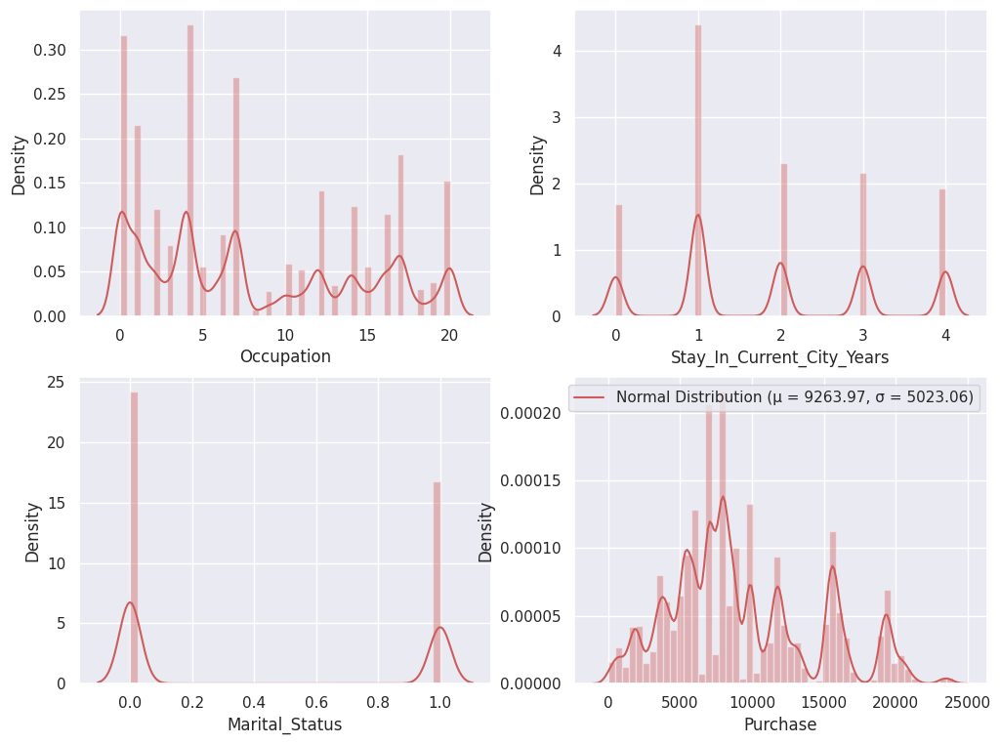

In [79]:
fig, axis = plt.subplots(nrows = 2, ncols = 2, figsize = (12, 10))
fig.subplots_adjust(top = 0.8)

# Plot distribution plots for specific columns
sns.distplot(df['Occupation'], kde = True, ax = axis[0, 0], color = '#CD5C5C')
sns.distplot(df['Stay_In_Current_City_Years'], kde = True, ax = axis[0, 1], color = '#CD5C5C')
sns.distplot(df['Marital_Status'], kde = True, ax = axis[1, 0], color = '#CD5C5C')

# Plot distribuition plot for `Purchase` with normal curve fit
sns.distplot(df['Purchase'], kde = True, ax = axis[1, 1], color = '#CD5C5C')

# Fitting target variable to the normal curve
mu, sigma = norm.fit(df['Purchase'])
print(f"Mean: {mu}, Standard Deviation: {sigma}")

# Adding legend to the 'Purchase' distribution plot
axis[1, 1].legend(['Normal Distribution (μ = {:.2f}, σ = {:.2f})'.format(mu, sigma)], loc = 'best')

plt.show()

In [80]:
# Count plots for each feature
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# create subplots
fig = make_subplots(rows = 4, cols = 2,
                    subplot_titles = ('Gender', 'Age', 'Occupation', 'City_Category', 'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category', 'Purchase')
)

# add histograms for each subplot
fig.add_trace(go.Histogram(x = df['Gender'], name = 'Gender'), row = 1, col = 1)
fig.add_trace(go.Histogram(x = df['Age'], name = 'Age'), row = 1, col = 2)
fig.add_trace(go.Histogram(x = df['Occupation'], name = 'Occupation'), row = 2, col = 1)
fig.add_trace(go.Histogram(x = df['City_Category'], name = 'City_Category'), row = 2, col = 2)
fig.add_trace(go.Histogram(x = df['Stay_In_Current_City_Years']), row=3, col=1)
fig.add_trace(go.Histogram(x = df['Marital_Status']), row=3, col=2)
fig.add_trace(go.Histogram(x = df['Product_Category']), row=4, col=1)
fig.add_trace(go.Histogram(x = df['Purchase']), row=4, col=2)

# adjust layout
fig.update_layout(height = 1000, width = 1200, showlegend = False, title_text = 'Count Plots for Each Feature')

fig.show()

**Key Obersavations**

- Male : Female = 4 : 1
- 7 age groups to categorize customers.
- Most buyers are single.
- Occupation 8 has the lowest count of customers, can may be ignored.
- Majority of the products are in 1, 5, and 8. The lowest number of categories can may be combined into a single category to reduce the complexity of the problem.
- City B has a higher count, indicating more population, following by C and A.
- Most buyers only live 1 year in the city while the other categories remain in a uniform distribution.

## Categorical Features

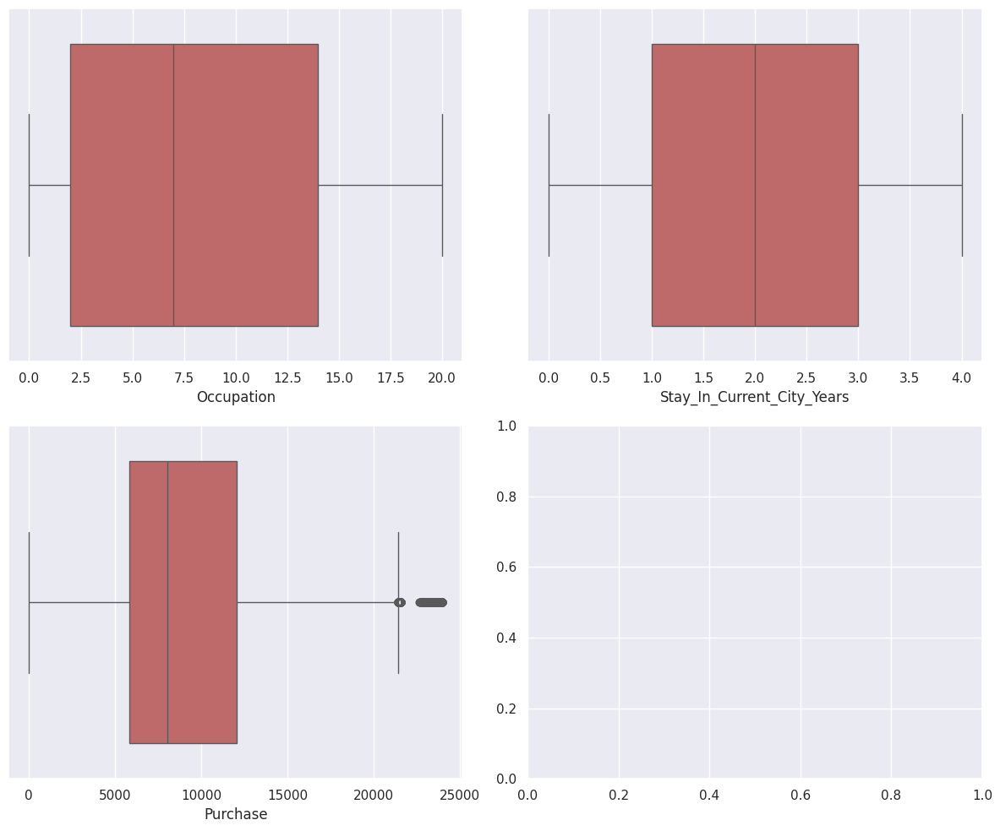

In [81]:
# plot box plots for categorical features
fig, axis = plt.subplots(nrows = 2, ncols = 2, figsize = (12, 10))
fig.subplots_adjust(top = 0.8)

# plotting
sns.boxplot(x = 'Occupation', data = df, ax = axis[0, 0], color = '#CD5C5C')
sns.boxplot(x = 'Stay_In_Current_City_Years', data = df, ax = axis[0, 1], color = '#CD5C5C')
sns.boxplot(x = 'Purchase', data = df, ax = axis[1, 0], color = '#CD5C5C')

# remove any empty plot
plt.tight_layout()

plt.show()

## Purchase vs Other Features

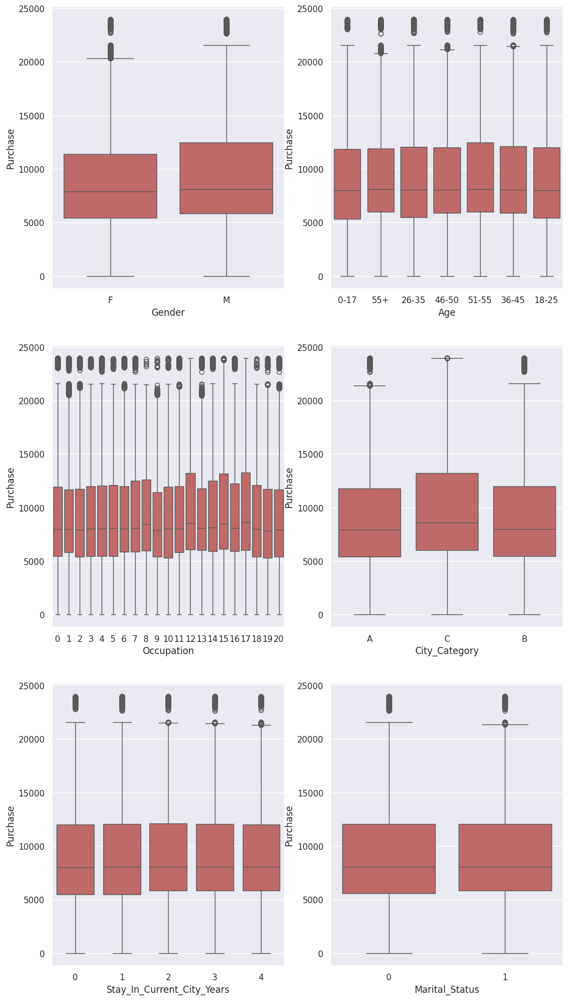

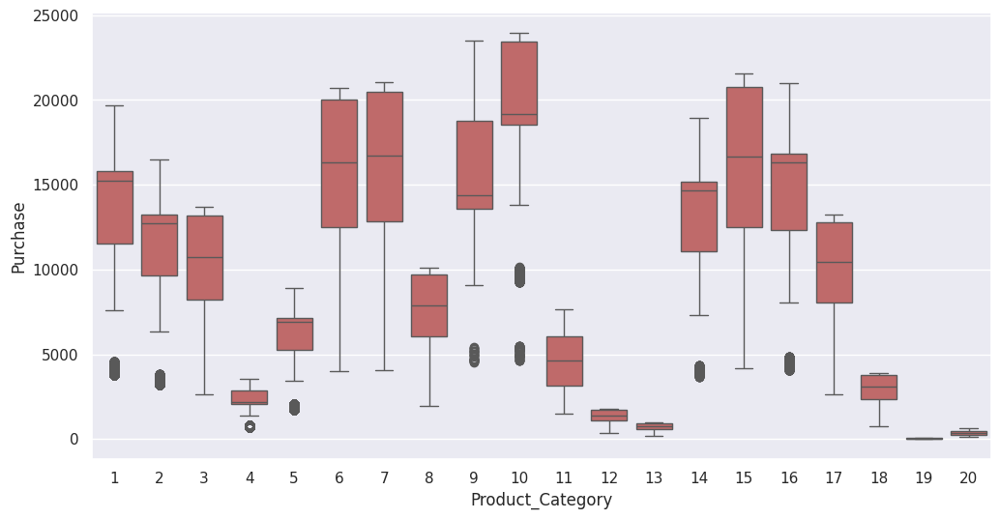

In [82]:
feat = ['Gender', 'Age', 'Occupation', 'City_Category', 'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category']

fig, axis = plt.subplots(nrows = 3, ncols = 2, figsize = (12, 16))
fig.subplots_adjust(top = 1.2)

# plotting
count = 0
for i in range(3):
  for j in range(2):
    sns.boxplot(x = feat[count], y = 'Purchase', data = df, ax = axis[i, j], color = '#CD5C5C')
    count += 1
plt.show()

# plot the last feature
plt.figure(figsize = (12, 6))
sns.boxplot(x = feat[-1], y = 'Purchase', data = df, color = '#CD5C5C')
plt.show()

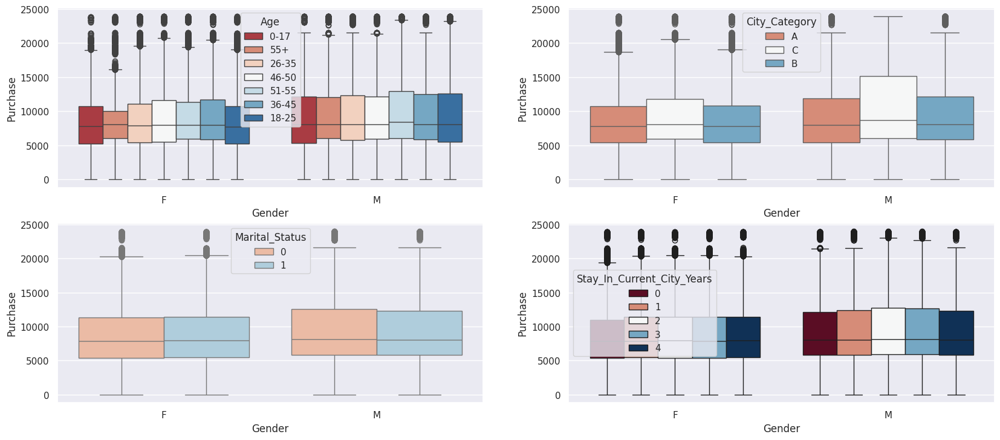

In [83]:
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize = (20, 6))

fig.subplots_adjust(top = 1.2)

# plot
sns.boxplot(data = df, y = 'Purchase', x = 'Gender', hue = 'Age', ax = axes[0, 0], palette = 'RdBu')
sns.boxplot(data = df, y = 'Purchase', x = 'Gender', hue = 'City_Category', ax = axes[0,1 ], palette = 'RdBu')
sns.boxplot(data = df, y = 'Purchase', x = 'Gender', hue = 'Marital_Status', ax = axes[1, 0], palette = 'RdBu')
sns.boxplot(data = df, y = 'Purchase', x = 'Gender', hue = 'Stay_In_Current_City_Years', ax = axes[1, 1], palette = 'RdBu')

plt.show()

In [84]:
df

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,1057
4,1000002,P00285442,M,55+,16,C,4,0,8,7969
...,...,...,...,...,...,...,...,...,...,...
550063,1006033,P00372445,M,51-55,13,B,1,1,20,368
550064,1006035,P00375436,F,26-35,1,C,3,0,20,371
550065,1006036,P00375436,F,26-35,15,B,4,1,20,137
550066,1006038,P00375436,F,55+,1,C,2,0,20,365


# **Data Analysis**

**1. Are women spending more money per transaction than men? Why or why not?**

In [85]:
# total purchase amount per customer
df_purchase = df.groupby(['User_ID', 'Gender'])['Purchase'].sum().reset_index()

In [86]:
df_purchase

,User_ID,Gender,Purchase
0,1000001,F,334093
1,1000002,M,810472
2,1000003,M,341635
3,1000004,M,206468
4,1000005,M,821001
...,...,...,...
5886,1006036,F,4116058
5887,1006037,F,1119538
5888,1006038,F,90034
5889,1006039,F,590319


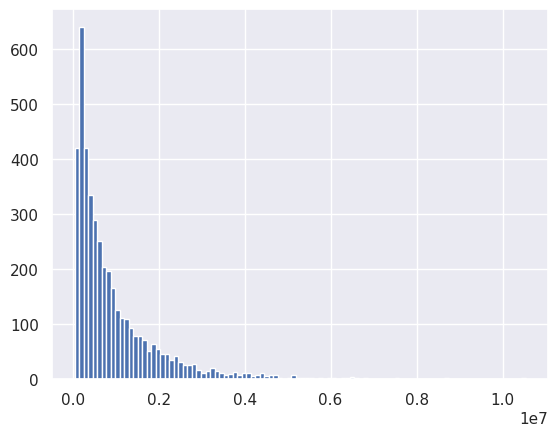

In [87]:
# histogram of average amount spent for each customer - Male
df_purchase[df_purchase['Gender'] == 'M']['Purchase'].hist(bins = 100)
plt.show()

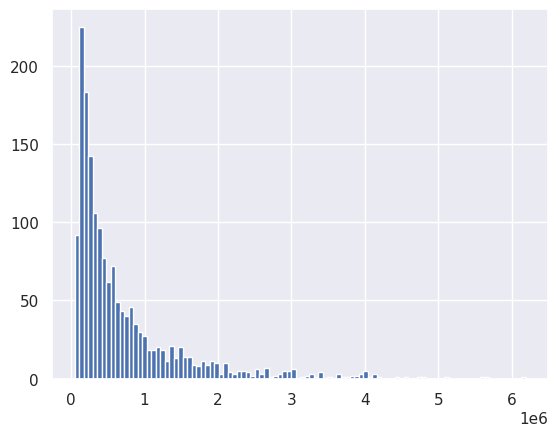

In [88]:
# histogram of average amount spent for each customer - Female
df_purchase[df_purchase['Gender'] == 'F']['Purchase'].hist(bins = 100)
plt.show()

In [89]:
male_mean = df_purchase[df_purchase['Gender'] == 'M']['Purchase'].mean()
female_mean = df_purchase[df_purchase['Gender'] == 'F']['Purchase'].mean()

print(f'Average amount spend by Male customers:{male_mean: .2f}' )
print(f'Average amount spend by Female customers: {female_mean: .2f}')

Average amount spend by Male customers: 925344.40
Average amount spend by Female customers:  712024.39


- Both female and male purchase amount are highly right skewed - mostly people spent less amount of money and only only a few had large purchases. Male customers had an overall high spending trend (over $600) vs female.

**2. Confidence intervals and distribution of the mean of the expenses by female and male customers**

## Bootstrap Method to Estimate CI Based on Gender

**Why Bootstrap Over Z-Test/T-Test?**

- The bootstrap method is useful when you cannot assume a normal distribution or when the sample size is relatively small.
- It does not require assumptions about the population distribution, making it more flexible in cases where the underlying data is skewed, as might be the case here with the purchase data.
- Additionally, since the data may not follow a normal distribution, a Z-test or t-test might not provide reliable confidence intervals, which is why the bootstrap method was chosen.

In [90]:
# 1. separate the data based on gender
male_purchase = df_purchase[df_purchase['Gender'] == 'M']['Purchase']
female_purchase = df_purchase[df_purchase['Gender'] == 'F']['Purchase']

In [91]:
# 2. bootstrap sampling

# set parameters for bootstrap
bootstrap_iterations = 1000
male_sample_size = len(male_purchase)
female_sample_size = len(female_purchase)

# lists to store bootstrap means
bootstrap_male_means = []
bootstrap_female_means = []

# bootstrap process for males and females
for _ in range(bootstrap_iterations):
  male_sample_mean = male_purchase.sample(male_sample_size, replace = True).mean()
  female_sample_mean = female_purchase.sample(female_sample_size, replace = True).mean()

  bootstrap_male_means.append(male_sample_mean)
  bootstrap_female_means.append(female_sample_mean)

In [92]:
# 3. calculate 95% CI from the bootstrap distributions (percentiles)
male_ci = np.percentile(bootstrap_male_means, [2.5, 97.5])
female_ci = np.percentile(bootstrap_female_means, [2.5, 97.5])

print(f'95% Confidence Interval for Male: {male_ci}')
print(f'95% Confidence Interval for Female: {female_ci}')

95% Confidence Interval for Male: [895805.64118935 954106.02928402]
95% Confidence Interval for Female: [670968.74483794 750643.14072629]


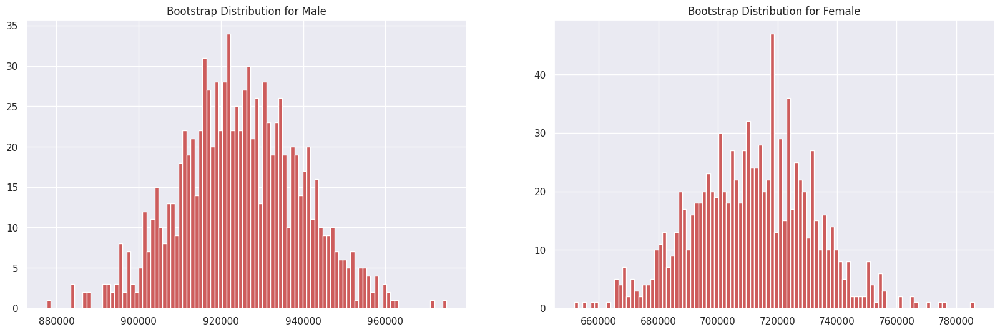

In [93]:
# plot male and female bootstrap distribution
fig, axis = plt.subplots(nrows = 1, ncols = 2, figsize = (20, 6))

axis[0].hist(bootstrap_male_means, bins = 100, color = '#CD5C5C')
axis[1].hist(bootstrap_female_means, bins = 100, color = '#CD5C5C')

axis[0].set_title('Bootstrap Distribution for Male')
axis[1].set_title('Bootstrap Distribution for Female')

plt.show()

**3. Are confidence intervals of average male and female spending overlapping? How can Walmart leverage this conclusion to make changes or improvements?**

- The confidence intervals of the two groups are not overlapping.
- Walmart could introduce gender-specific marketing campaigns. For example, targeting females with promotions that encourage higher spending or focusing on product where females tend to spend more. For men, Walmart can highlight premium products or bundles since the data indicates that they are more likely to make larger purcahses.


**4. Results when the same activity is performed for Married vs Unmarried**

## Bootstrap Based on Marital Status

In [94]:
# 1. separate the data based on marital status
married_purchase = df[df['Marital_Status'] == 1]['Purchase']
unmarried_purchase = df[df['Marital_Status'] == 0]['Purchase']

In [95]:
# 2. bootstrap method
bootstrap_iterations = 1000
married_sample_size = len(married_purchase)
unmarried_sample_size = len(unmarried_purchase)

# lists to store bootstrap
bootstrap_married_means = []
bootstrap_unmarried_means = []

# bootstrap
for _ in range(bootstrap_iterations):
  married_sample_mean = married_purchase.sample(married_sample_size, replace = True).mean()
  unmarried_sample_mean = unmarried_purchase.sample(unmarried_sample_size, replace = True).mean()

  bootstrap_married_means.append(married_sample_mean)
  bootstrap_unmarried_means.append(unmarried_sample_mean)

In [96]:
# 3. calculate 95% CI for unmarried and married
ci_unmarried = np.percentile(bootstrap_unmarried_means, [2.5, 97.5])
ci_married = np.percentile(bootstrap_married_means, [2.5, 97.5])

print(f'95% Confidence Interval for Unmarried: {ci_unmarried}')
print(f'95% Confidence Interval for Married: {ci_married}')

95% Confidence Interval for Unmarried: [9249.15868534 9284.20717963]
95% Confidence Interval for Married: [9240.17078742 9281.06980312]


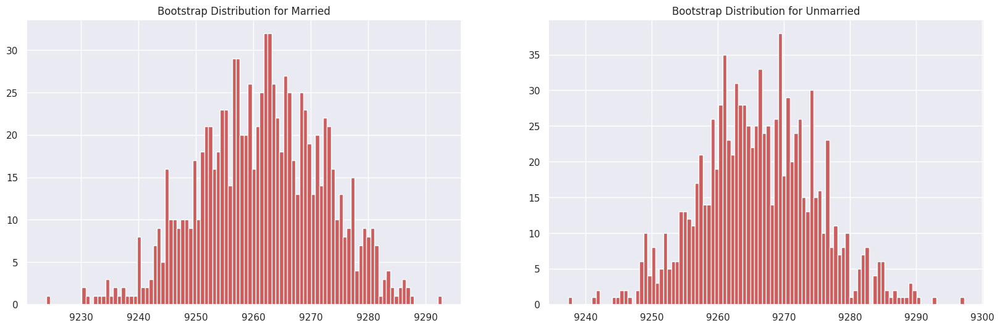

In [97]:
# plot unmarried and married bootstrap distribution
fig, axis = plt.subplots(nrows = 1, ncols = 2, figsize = (20, 6))

axis[0].hist(bootstrap_married_means, bins = 100, color = '#CD5C5C')
axis[1].hist(bootstrap_unmarried_means, bins = 100, color = '#CD5C5C')

axis[0].set_title('Bootstrap Distribution for Married')
axis[1].set_title('Bootstrap Distribution for Unmarried')

plt.show()

## Bootstrap on Age Groups

**5. Results when the same activity is performed for Age**

We will analyze the spending patterns of customers in different age groups. By calculating confidence intervals for each age group, we can see which age range tends to spend more and how certain age groups differ in their spending habits.

In [98]:
# 1. list out the age groups in the dataset
age_groups = df['Age'].unique()

In [99]:
age_groups

array(['0-17', '55+', '26-35', '46-50', '51-55', '36-45', '18-25'],
      dtype=object)

In [100]:
# 2. create dictionary to store bootstrap means for each age group
bootstrap_age_means = {}

In [101]:
# 3. bootstrap iterations
bootstrap_iterations = 1000

In [102]:
# 4. loop over each age group and calculate bootstrap means
for age in age_groups:

  # filter data for the current age group
  age_group_purchase = df[df['Age'] == age]['Purchase']

  # store bootstrap means for this age group
  bootstrap_age_means[age] = []

  for _ in range(bootstrap_iterations):
    sample_mean = age_group_purchase.sample(len(age_group_purchase), replace = True).mean()
    bootstrap_age_means[age].append(sample_mean)

In [103]:
# Now calculate the 95% confidence interval for each age group
ci_age_groups = {}

for age_group, means in bootstrap_age_means.items():
    ci_lower = np.percentile(means, 2.5)
    ci_upper = np.percentile(means, 97.5)
    ci_age_groups[age_group] = (ci_lower, ci_upper)

# Display the confidence intervals for each age group
for age_group, ci in ci_age_groups.items():
    print(f'95% Confidence Interval for Age Group {age_group}: {ci}')

95% Confidence Interval for Age Group 0-17: (8860.551143888228, 9017.56704410012)
95% Confidence Interval for Age Group 55+: (9269.973043387277, 9400.032570684523)
95% Confidence Interval for Age Group 26-35: (9232.119752307743, 9273.29662058774)
95% Confidence Interval for Age Group 46-50: (9165.11181812214, 9254.885906763528)
95% Confidence Interval for Age Group 51-55: (9481.92717981351, 9580.95874392873)
95% Confidence Interval for Age Group 36-45: (9301.168103769556, 9361.398576986356)
95% Confidence Interval for Age Group 18-25: (9140.458320539834, 9198.788919074854)


In [106]:
df.groupby('Age')['Purchase'].sum()

,Purchase
Age,
0-17,134913183
18-25,913848675
26-35,2031770578
36-45,1026569884
46-50,420843403
51-55,367099644
55+,200767375


# **Final Insights**

## **Actionable Insights**

- For `Age` feature, we observed that most customers (over 80%) who belong to the age group 25-40 spend the most
- For `Gender` feature, male vs female is around 4:1. Also, male spend more than female:
  - Average amount spend by Male customers: 9,25,408.28
  - Average amount spend by Female customers: 7,12,217.18
- When combining `Purchase` with `Gender` and `Marital_Status`, we can see that single men spend the most during Black Friday. In other words, it also tells men tend to spend less once they get married.
- After analyzing `Stay_In_Current_Years`, we came to know that those who have stayed for 4 years tend to have a wider range of purchase amounts. This also suggests that purchase behavior does not differ dramatically between males and females, but the number of years spent in the current city might have some impact on purchase variability, with longer stays (e.g., 4 years) leading to a higher spread in spending.
- When examining `City_Category`, which was the city the product was purchased, even though city B is majorly responsible for the overall sales income, on average, purchases in City C are higher. This suggests that while more transactions occur in City B, the individual transaction values might be smaller, compared to those in City C, which has fewer customers but higher average spending per customer.
- For `Product_Category`, 6 and 15 stand out as high-value categories with considerable variability, meaning they likely contain more expensive products.
Categories 4, 12, 13, 19, and 20 involve lower purchase amounts and show less variability, which suggests these might be more affordable or consistent-price products. However, product 1, 5, 8, 11 have highest purchasing frequency.

## **Confidence Interval**

1. Gender:

- 95% Confidence Interval for Male: [895805.64118935 954106.02928402]
- 95% Confidence Interval for Female: [670968.74483794 750643.14072629]


2. Marital Status:

- 95% Confidence Interval for Unmarried: [9249.15868534 9284.20717963]
- 95% Confidence Interval for Married: [9240.17078742 9281.06980312]


3. Age group:

- 95% Confidence Interval for Age Group 0-17: (8860.55, 9017.56)
- 95% Confidence Interval for Age Group 55+: (9269.97, 9400.03)
- 95% Confidence Interval for Age Group 26-35: (9232.11, 9273.29)
- 95% Confidence Interval for Age Group 46-50: (9165.11, 9254.88)
- 95% Confidence Interval for Age Group 51-55: (9481.92, 9580.95)
- 95% Confidence Interval for Age Group 36-45: (9301.16, 9361.39)
- 95% Confidence Interval for Age Group 18-25: (9140.45, 9198.78)

## **Recommendations**

1. Since males have a higher confidence interval for purchase amounts compared to females, consider focusing high-value product marketing or promotional campaigns towards male customers, as they seem to spend more.
For Marital Status-Based Offers:

2. There is not a significant difference between the purchase behaviors of unmarried and married individuals. Therefore, marital status should not be the primary segmentation criterion for differentiated marketing strategies.

3. Age Groups 51-55 and 55+ have higher upper limits in their confidence intervals, indicating that these age groups tend to make higher purchases. Consider offering premium or higher-end products to these demographics.
For younger age groups like 18-25 and 26-35, while their spending is relatively consistent, focusing on products that appeal to price-conscious consumers with moderate spending might be more effective.